In [1]:
from sqlalchemy import create_engine, inspect
import subprocess
import pandas as pd
import geopandas as gpd
import psycopg2
from psycopg2 import sql
import plotly.express as px
import matplotlib.pyplot as plt
import time
import sys
import folium
import os

# move current directory to /Users/tanyatsui/Documents/01_Projects/housingEmissions
os.chdir('/Users/tanyatsui/Documents/01_Projects/housingEmissions')

In [2]:
# create a connection to the database
db_name = 'urbanmining'
db_user = 'postgres'
db_password = 'Tunacompany5694!'
db_host = 'localhost'
db_port = '5432'
engine = create_engine(f'postgresql://{db_user}:{db_password}@{db_host}:{db_port}/{db_name}')


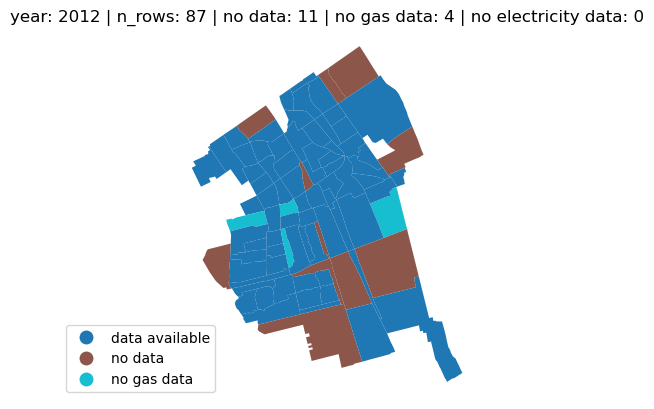

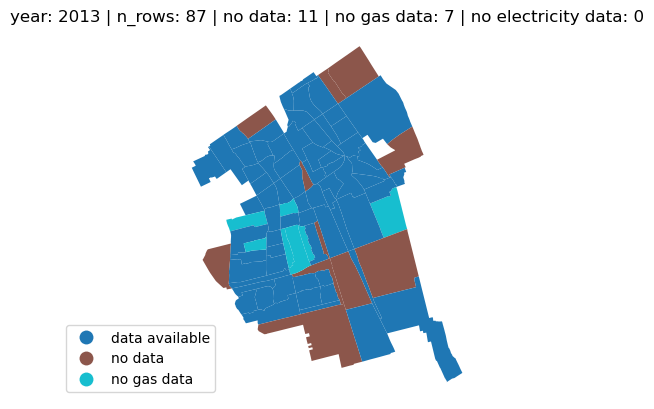

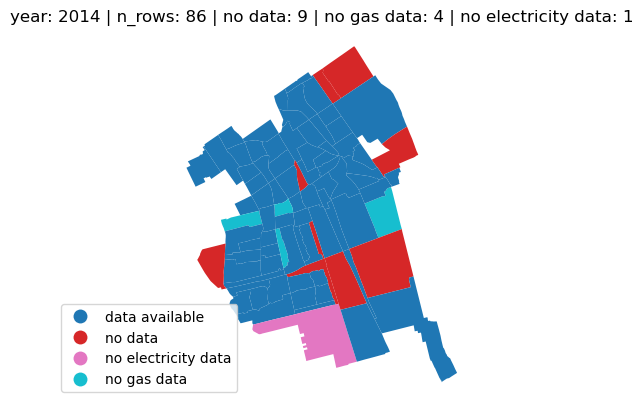

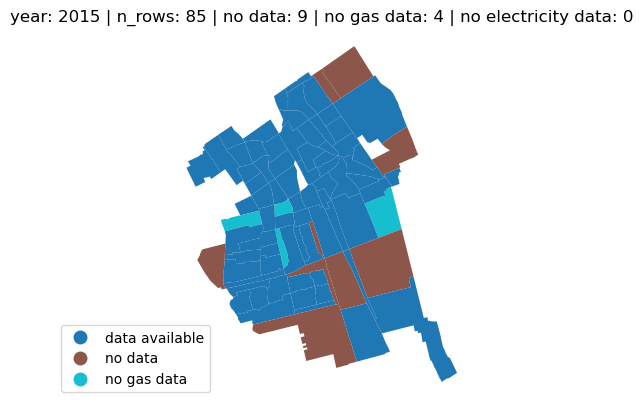

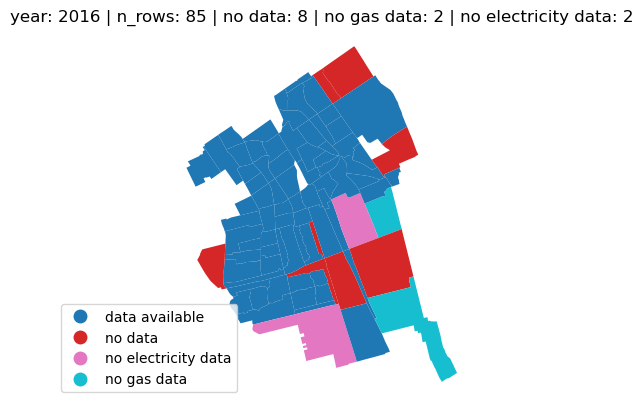

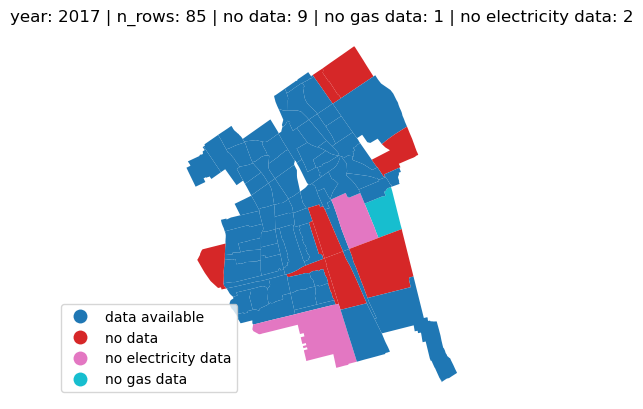

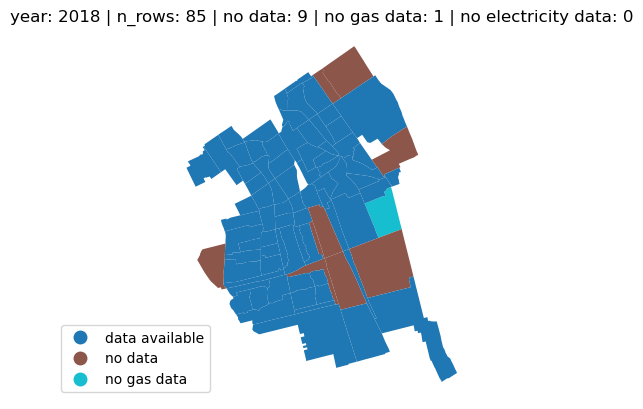

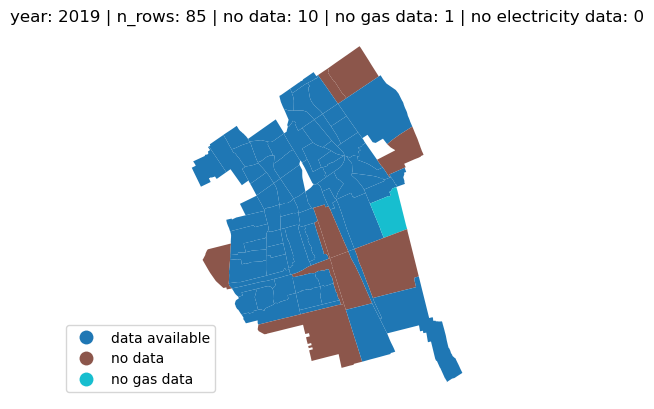

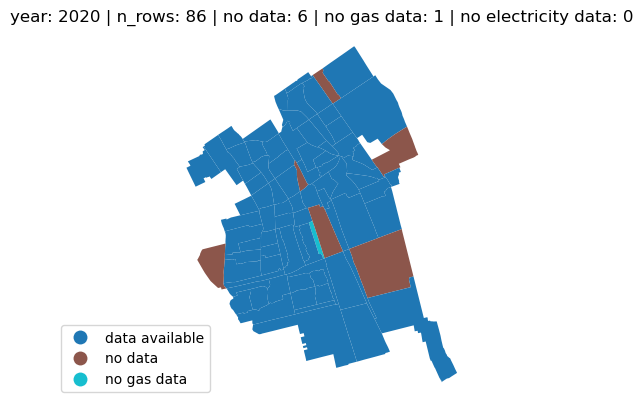

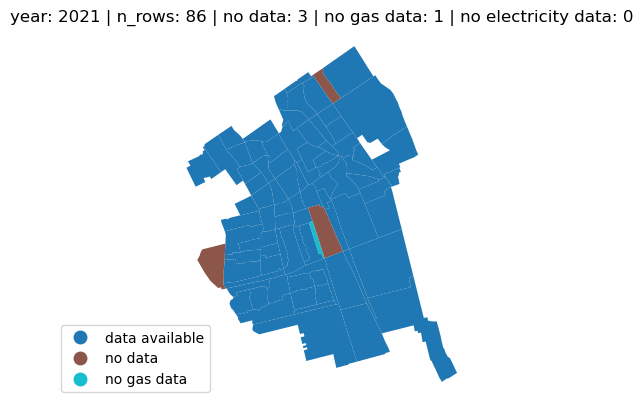

In [34]:
year = 2012
for year in range(2012, 2022): 
    query = f''' 
    SELECT * -- DISTINCT bu_code
    FROM cbs_map_all_buurt 
    WHERE municipality = 'Delft'
        AND year = {year} 
    ''' 

    gdf = gpd.read_postgis(query, engine, geom_col='bu_geom')
    def pickType(row): 
        if pd.isnull(row.tot_gas_m3) and pd.isnull(row.tot_elec_kwh): 
            return 'no data'
        elif pd.isnull(row.tot_gas_m3) and not pd.isnull(row.tot_elec_kwh): 
            return 'no gas data'
        elif not pd.isnull(row.tot_gas_m3) and pd.isnull(row.tot_elec_kwh):
            return 'no electricity data'
        else:
            return 'data available'
    gdf['data_type'] = gdf.apply(lambda row: pickType(row), axis=1)

    title = f'year: {year} | n_rows: {len(gdf)} | no data: {len(gdf[gdf.data_type == "no data"])} | no gas data: {len(gdf[gdf.data_type == "no gas data"])} | no electricity data: {len(gdf[gdf.data_type == "no electricity data"])}'
    fig, ax = plt.subplots(1, 1)
    gdf.plot(column='data_type', legend=True, ax=ax, legend_kwds={'loc': 'lower left', 'bbox_to_anchor': (-0.4, 0)})
    ax.set_title(title)
    ax.set_axis_off()
    plt.show()

In [5]:
df_all = pd.DataFrame()
for year in range(2012, 2022): 
    query = f''' 
    SELECT
        "WONINGEN", "G_GAS_TOT", "G_ELEK_TOT", "BU_CODE" -- , geometry
    FROM cbs_map_{year}
    ORDER BY "G_GAS_TOT" DESC
    LIMIT 10
    '''
    df = pd.read_sql_query(query, engine)
    df['year'] = year
    df_all = pd.concat([df_all, df])

df_all.sort_values(by='G_GAS_TOT', ascending=False).head()

,WONINGEN,G_GAS_TOT,G_ELEK_TOT,BU_CODE,year
0,9.0,7400.0,-99999997.0,BU06290009,2013
0,10.0,6900.0,-99999997.0,BU06290009,2012
1,38.0,6400.0,4650.0,BU09350301,2013
0,9.0,6320.0,-99999999.0,BU02740107,2016
0,10.0,6270.0,-99999999.0,BU06290009,2018


In [6]:
df_all = pd.DataFrame()
for year in range(2012, 2022): 
    query = f''' 
    SELECT
        "WONINGEN", "G_GAS_TOT", "G_ELEK_TOT", "BU_CODE" -- , geometry
    FROM cbs_map_{year}
    ORDER BY "G_ELEK_TOT" DESC
    LIMIT 10
    '''
    df = pd.read_sql_query(query, engine)
    df['year'] = year
    df_all = pd.concat([df_all, df])

df_all.sort_values(by='G_ELEK_TOT', ascending=False).head()

,WONINGEN,G_GAS_TOT,G_ELEK_TOT,BU_CODE,year
0,15.0,4400.0,8750.0,BU02220803,2012
0,15.0,3700.0,8650.0,BU02220803,2014
0,14.0,4800.0,8550.0,BU02220803,2013
1,30.0,3750.0,8550.0,BU02810109,2012
1,40.0,0.0,8450.0,BU04390505,2013


In [8]:
query = ''' 
WITH wijken AS (
	SELECT wk_code, gm_naam AS municipality, ST_Buffer(geom, 200) AS wk_geom_buffer, geom AS wk_geom
	FROM cbs_wijk_2012
	WHERE gm_naam = 'Amsterdam'
), 	
municipality_bbox AS (
	SELECT ST_Extent(wk_geom) AS bbox
	FROM wijken
), 
buurten AS (
	SELECT "BU_CODE" AS neighborhood_code, geometry AS neighborhood_geom
	FROM cbs_map_2022, municipality_bbox
	WHERE "WATER" = 'NEE'
		AND geometry && bbox
), 
buurten_with_wijk AS (
	SELECT b.neighborhood_code, b.neighborhood_geom, w.wk_code, w.municipality, w.wk_geom
	FROM buurten b  
	JOIN wijken w 
	ON b.neighborhood_geom && w.wk_geom
		AND ST_Within(b.neighborhood_geom, w.wk_geom_buffer)
), 
duplicates AS (
    SELECT neighborhood_code
    FROM buurten_with_wijk
    GROUP BY neighborhood_code
    HAVING COUNT(*) > 1
)

-- Final selection of duplicated rows
SELECT bw.*
FROM buurten_with_wijk bw
JOIN duplicates d ON bw.neighborhood_code = d.neighborhood_code
ORDER BY neighborhood_code
'''

neighborhoods = gpd.read_postgis(query, engine, geom_col='neighborhood_geom')
wijken = gpd.read_postgis(query, engine, geom_col='wk_geom')
neighborhoods.head()

,neighborhood_code,neighborhood_geom,wk_code,municipality,wk_geom
0,BU03630505,"POLYGON ((120862.566 489041.647, 120858.957 48...",WK036300,Amsterdam,010600002040710000010000000103000000010000005E...
1,BU03630505,"POLYGON ((120862.566 489041.647, 120858.957 48...",WK036302,Amsterdam,0106000020407100000100000001030000000100000063...
2,BU03630506,"POLYGON ((120746.718 488764.289, 120736.457 48...",WK036300,Amsterdam,010600002040710000010000000103000000010000005E...
3,BU03630506,"POLYGON ((120746.718 488764.289, 120736.457 48...",WK036302,Amsterdam,0106000020407100000100000001030000000100000063...
4,BU03630603,"POLYGON ((120603.332 488589.163, 120640.429 48...",WK036300,Amsterdam,010600002040710000010000000103000000010000005E...


In [9]:
problem_code = 'BU03630505'
problem_neighborhood = neighborhoods[neighborhoods.neighborhood_code == problem_code]
problem_wijk = wijken[wijken.neighborhood_code == problem_code]

# plot in folium
m = folium.Map(location=[52.379189, 4.899431], zoom_start=12)
folium.GeoJson(problem_neighborhood).add_to(m)
folium.GeoJson(problem_wijk).add_to(m)
m

In [5]:
import zipfile
import io

# Path to the outer ZIP file
outer_zip_path = 'data/raw/bag/lvbag-extract-nl.zip'
nested_zip_name = '9999VBO08082024.zip'  # Name of the nested ZIP file within the outer ZIP

# Open the outer ZIP file
with zipfile.ZipFile(outer_zip_path, 'r') as outer_zip:
    # Open the nested ZIP file as a bytes stream
    with outer_zip.open(nested_zip_name) as nested_zip_file:
        # Load the nested ZIP file into memory
        nested_zip_data = io.BytesIO(nested_zip_file.read())
        
        # Open the nested ZIP file
        with zipfile.ZipFile(nested_zip_data, 'r') as nested_zip:
            # List all files in the nested ZIP archive
            nested_file_list = nested_zip.namelist()
            print("Files in the nested ZIP archive:", nested_file_list)
            
            # Example: Read a specific file from the nested ZIP archive
            nested_file_to_read = nested_file_list[0]  # Replace with the actual file name if needed
            with nested_zip.open(nested_file_to_read) as file:
                content = file.read()  # Read the file content
                print(content.decode())  # Decode the content if it’s text-based



Files in the nested ZIP archive: ['9999VBO08082024-000001.xml', '9999VBO08082024-000002.xml', '9999VBO08082024-000003.xml', '9999VBO08082024-000004.xml', '9999VBO08082024-000005.xml', '9999VBO08082024-000006.xml', '9999VBO08082024-000007.xml', '9999VBO08082024-000008.xml', '9999VBO08082024-000009.xml', '9999VBO08082024-000010.xml', '9999VBO08082024-000011.xml', '9999VBO08082024-000012.xml', '9999VBO08082024-000013.xml', '9999VBO08082024-000014.xml', '9999VBO08082024-000015.xml', '9999VBO08082024-000016.xml', '9999VBO08082024-000017.xml', '9999VBO08082024-000018.xml', '9999VBO08082024-000019.xml', '9999VBO08082024-000020.xml', '9999VBO08082024-000021.xml', '9999VBO08082024-000022.xml', '9999VBO08082024-000023.xml', '9999VBO08082024-000024.xml', '9999VBO08082024-000025.xml', '9999VBO08082024-000026.xml', '9999VBO08082024-000027.xml', '9999VBO08082024-000028.xml', '9999VBO08082024-000029.xml', '9999VBO08082024-000030.xml', '9999VBO08082024-000031.xml', '9999VBO08082024-000032.xml', '9999V

In [3]:
import fiona

# Path to your GeoPackage file
file_path = 'data/raw/cbs/wijkEnBuurtKaart/WijkBuurtkaart_2024_v1/wijkenbuurten_2024_v1.gpkg'

# List all layers in the GeoPackage
layers = fiona.listlayers(file_path)
print("Layers in the GeoPackage:", layers)


Layers in the GeoPackage: ['buurten', 'gemeenten', 'wijken']


In [8]:
city_name = 'Utrecht'

query = f''' 
WITH construction_sample AS (
	SELECT id_pand, 
		CASE 
			WHEN status = 'Pand gesloopt' THEN LEFT(registration_start, 4)::INTEGER
			WHEN status != 'Pand gesloopt' AND registration_end IS NOT NULL THEN LEFT(registration_end, 4)::INTEGER
			ELSE LEFT(registration_start, 4)::INTEGER
		END AS year, 
		status, sqm, geom, geom_28992, neighborhood_code, municipality
	FROM housing_nl
	WHERE municipality = '{city_name}'
), 
inuse_sample AS (
	SELECT id_pand, year, status, sqm, geom, geom_28992, neighborhood_code, municipality
	FROM housing_inuse_2012_2022
	WHERE municipality = '{city_name}'
		AND year > 2011 AND year < 2022
), 
inuse_lowenergy AS (
	SELECT 
		b.id_pand, b.year, 'Pand in gebruik - low energy' AS status, b.sqm, b.geom, b.geom_28992, b.neighborhood_code, b.municipality
	FROM construction_sample a 
	LEFT JOIN inuse_sample b 
	ON a.id_pand = b.id_pand
	WHERE a.status != 'Pand gesloopt'
		AND a.year > 2011 AND a.year < 2022
		AND b.id_pand IS NOT NULL
), 
inuse_normalenergy AS (
	SELECT b.*
	FROM construction_sample a 
	RIGHT JOIN inuse_sample b 
	ON a.id_pand = b.id_pand
	WHERE a.id_pand IS NULL 
), 
buildings_sample AS (
	SELECT * FROM construction_sample
	UNION ALL 
	SELECT * FROM inuse_lowenergy
	UNION ALL 
	SELECT * FROM inuse_normalenergy
), 

-- join neighborhood sqm and energy into to buildings 
sqm_neighborhood AS (
	SELECT municipality, neighborhood_code, year, SUM(sqm) AS sqm_neighborhood
	FROM inuse_sample
	GROUP BY municipality, neighborhood_code, year
), 
energy_sample AS (
	SELECT year, neighborhood_code, municipality, 
		electricity_kwh * n_households AS electricity_kwh_buurt, 
		gas_m3 * n_households AS gas_m3_buurt 
	FROM cbs_map_all 
	WHERE municipality = '{city_name}'
), 
neighborhood_stats AS (
	SELECT b.*, a.sqm_neighborhood
	FROM sqm_neighborhood a 
	JOIN energy_sample b 
	ON a.neighborhood_code = b.neighborhood_code
		AND a.year = b.year
), 


-- emissions 
emissions_input AS (
	SELECT a.id_pand, a.year, a.status, a.sqm, 
		ROUND(a.sqm / b.sqm_neighborhood * gas_m3_buurt) AS gas_m3_s0, 
		CASE 
			WHEN status IN ('Pand in gebruik', 'Pand in gebruik - low energy') THEN ROUND(a.sqm / b.sqm_neighborhood * electricity_kwh_buurt) 
			ELSE 0 
		END AS electricity_kwh_s0, 
		CASE
			WHEN status = 'Pand in gebruik' THEN ROUND(a.sqm / b.sqm_neighborhood * gas_m3_buurt)
			WHEN status = 'Pand in gebruik - low energy' THEN a.sqm * 5
			ELSE 0 
		END AS gas_m3_s1, 
		CASE 
			WHEN status IN ('Pand in gebruik', 'Pand in gebruik - low energy') THEN ROUND(a.sqm / b.sqm_neighborhood * electricity_kwh_buurt) 
			ELSE 0 
		END AS electricity_kwh_s1
	FROM buildings_sample a 
	JOIN neighborhood_stats b
	ON a.neighborhood_code = b.neighborhood_code
		AND a.year = b.year
	WHERE a.status IN ('Pand in gebruik', 'Pand in gebruik - low energy')
)
SELECT * FROM emissions_input 
WHERE RANDOM() < 0.001
'''

df_emissions_input = pd.read_sql_query(query, engine)

In [45]:
df_emissions_input_all = pd.DataFrame()
municipalities = pd.read_sql_query('''SELECT "GM_NAAM" FROM nl_gemeenten TABLESAMPLE BERNOULLI(1)''' , engine)
city_list = ['Amsterdam', 'Rotterdam', 'Delft', 'Utrecht', 'Almere'] + list(municipalities.GM_NAAM)

print(f'getting data for {len(city_list)} cities: {city_list}...')
for city_name in city_list: 
    query = f''' 
    WITH construction_sample AS (
        SELECT id_pand, 
            CASE 
                WHEN status = 'Pand gesloopt' THEN LEFT(registration_start, 4)::INTEGER
                WHEN status != 'Pand gesloopt' AND registration_end IS NOT NULL THEN LEFT(registration_end, 4)::INTEGER
                ELSE LEFT(registration_start, 4)::INTEGER
            END AS year, 
            status, sqm, geom, geom_28992, neighborhood_code, municipality
        FROM housing_nl
        WHERE municipality = '{city_name}'
    ), 
    inuse_sample AS (
        SELECT id_pand, year, status, sqm, geom, geom_28992, neighborhood_code, municipality
        FROM housing_inuse_2012_2022
        WHERE municipality = '{city_name}'
            AND year > 2011 AND year < 2022
    ), 
    inuse_lowenergy AS (
        SELECT 
            b.id_pand, b.year, 'Pand in gebruik - low energy' AS status, b.sqm, b.geom, b.geom_28992, b.neighborhood_code, b.municipality
        FROM construction_sample a 
        LEFT JOIN inuse_sample b 
        ON a.id_pand = b.id_pand
        WHERE a.status != 'Pand gesloopt'
            AND a.year > 2011 AND a.year < 2022
            AND b.id_pand IS NOT NULL
    ), 
    inuse_normalenergy AS (
        SELECT b.*
        FROM construction_sample a 
        RIGHT JOIN inuse_sample b 
        ON a.id_pand = b.id_pand
        WHERE a.id_pand IS NULL 
    ), 
    buildings_sample AS (
        SELECT * FROM construction_sample
        UNION ALL 
        SELECT * FROM inuse_lowenergy
        UNION ALL 
        SELECT * FROM inuse_normalenergy
    ), 

    -- join neighborhood sqm and energy into to buildings 
    sqm_neighborhood AS (
        SELECT municipality, neighborhood_code, year, SUM(sqm) AS sqm_neighborhood
        FROM inuse_sample
        GROUP BY municipality, neighborhood_code, year
    ), 
    energy_sample AS (
        SELECT year, neighborhood_code, municipality, 
            electricity_kwh * n_households AS electricity_kwh_buurt, 
            gas_m3 * n_households AS gas_m3_buurt 
        FROM cbs_map_all 
        WHERE municipality = '{city_name}'
    ), 
    neighborhood_stats AS (
        SELECT b.*, a.sqm_neighborhood
        FROM sqm_neighborhood a 
        JOIN energy_sample b 
        ON a.neighborhood_code = b.neighborhood_code
            AND a.year = b.year
    ), 


    -- emissions 
    emissions_input AS (
        SELECT a.id_pand, a.year, a.status, a.sqm, 
            ROUND(a.sqm / b.sqm_neighborhood * gas_m3_buurt) AS gas_m3_s0, 
            CASE 
                WHEN status IN ('Pand in gebruik', 'Pand in gebruik - low energy') THEN ROUND(a.sqm / b.sqm_neighborhood * electricity_kwh_buurt) 
                ELSE 0 
            END AS electricity_kwh_s0, 
            CASE
                WHEN status = 'Pand in gebruik' THEN ROUND(a.sqm / b.sqm_neighborhood * gas_m3_buurt)
                WHEN status = 'Pand in gebruik - low energy' THEN a.sqm * 5
                ELSE 0 
            END AS gas_m3_s1, 
            CASE 
                WHEN status IN ('Pand in gebruik', 'Pand in gebruik - low energy') THEN ROUND(a.sqm / b.sqm_neighborhood * electricity_kwh_buurt) 
                ELSE 0 
            END AS electricity_kwh_s1
        FROM buildings_sample a 
        JOIN neighborhood_stats b
        ON a.neighborhood_code = b.neighborhood_code
            AND a.year = b.year
        WHERE a.status IN ('Pand in gebruik', 'Pand in gebruik - low energy')
    )
    SELECT * FROM emissions_input 
    WHERE RANDOM() < 0.001
    '''

    print(f'getting data for {city_name}')
    df_emissions_input = pd.read_sql_query(query, engine)
    df_emissions_input['municipality'] = city_name
    df_emissions_input_all = pd.concat([df_emissions_input_all, df_emissions_input])

getting data for ['Amsterdam', 'Rotterdam', 'Delft', 'Utrecht', 'Almere', 'Bergen (NH.)', 'Gemert-Bakel', 'Hengelo', 'Voorschoten', 'Emmen', 'Baarn', 'Koggenland', 'Kerkrade', 'Heumen']...

getting data for Amsterdam
getting data for Rotterdam
getting data for Delft
getting data for Utrecht
getting data for Almere
getting data for Bergen (NH.)
getting data for Gemert-Bakel
getting data for Hengelo
getting data for Voorschoten
getting data for Emmen
getting data for Baarn
getting data for Koggenland
getting data for Kerkrade
getting data for Heumen


In [46]:
df = df_emissions_input_all.copy()

def isStrange(row): 
    if row.gas_m3_s0 / 5 < row.sqm: 
        return 'A++'
    elif row.gas_m3_s0 / 10 < row.sqm:
        return 'A'
    elif row.gas_m3_s0 / 12 < row.sqm:
        return 'B'
    elif row.gas_m3_s0 / 15 < row.sqm:
        return 'C'
    elif row.gas_m3_s0 / 17 < row.sqm:
        return 'D'
    elif row.gas_m3_s0 / 19 < row.sqm:
        return 'E'
    elif row.gas_m3_s0 / 20 < row.sqm:
        return 'F'
    elif row.gas_m3_s0 / 21 < row.sqm:
        return 'G or lower'
df['energy_label'] = df.apply(lambda row: isStrange(row), axis=1)
energy_label_order = ['A++', 'A', 'B', 'C', 'D', 'E', 'G or lower']
df['energy_label'] = pd.Categorical(df['energy_label'], categories=energy_label_order, ordered=True)
df.sort_values('energy_label', ascending=True, inplace=True)

df_bar = df.groupby(['municipality', 'energy_label'], observed=False).size().reset_index().rename(columns={0: 'count'})
df_bar['total'] = df_bar.groupby('municipality')['count'].transform('sum')
df_bar['percentage'] = df_bar['count'] / df_bar['total'] * 100
# df_bar = df_bar.drop(columns=['count', 'total'])

color_map = {
    'A++': '#5e6903',  # Gold for A++
    'A': '#829004',    # Tomato red for A
    'B': '#9A9F00',    # Lime green for B
    'C': '#BFB800',    # Medium purple for C
    'D': '#FFCF01',    # Orange for D
    'E': '#FAB701',    # Dodger blue for E
    'F': '#EA641B',    # Orange red for F
    'G or lower': '#E53B20'  # Orange red for G or lower
}

fig = px.bar(df_bar, x='municipality', y='percentage', color='energy_label', title=f'Energy labels in according to data', 
             category_orders={'energy_label': energy_label_order}, color_discrete_map=color_map)
fig.show()

In [161]:
# scatter plot of columns sqm and gas_m3_s0 in df
fig = px.scatter(df, x='sqm', y='gas_m3_s0')
fig.update_layout(width=600, height=600)
fig.show()

In [99]:
query = ''' 
WITH construction_sample AS (
	SELECT id_pand, 
		CASE 
			WHEN status = 'Pand gesloopt' THEN LEFT(registration_start, 4)::INTEGER
			WHEN status != 'Pand gesloopt' AND registration_end IS NOT NULL THEN LEFT(registration_end, 4)::INTEGER
			ELSE LEFT(registration_start, 4)::INTEGER
		END AS year, 
		status, sqm, geom, geom_28992, neighborhood_code, municipality
	FROM housing_nl
	WHERE municipality = 'Amsterdam'
), 
inuse_sample AS (
	SELECT id_pand, year, status, sqm, geom, geom_28992, neighborhood_code, municipality
	FROM housing_inuse_2012_2022
	WHERE municipality = 'Amsterdam'
		AND year < 2022
), 
inuse_lowenergy AS (
	SELECT 
		b.id_pand, b.year, 'Pand in gebruik - low energy' AS status, b.sqm, b.geom, b.geom_28992, b.neighborhood_code, b.municipality
	FROM construction_sample a 
	LEFT JOIN inuse_sample b 
	ON a.id_pand = b.id_pand
	WHERE a.status != 'Pand gesloopt'
		AND a.year < 2022
		AND b.id_pand IS NOT NULL
), 
inuse_normalenergy AS (
	SELECT b.*
	FROM construction_sample a 
	RIGHT JOIN inuse_sample b 
	ON a.id_pand = b.id_pand
	WHERE a.id_pand IS NULL 
), 
buildings_sample AS (
	SELECT * FROM construction_sample
	UNION ALL 
	SELECT * FROM inuse_lowenergy
	UNION ALL 
	SELECT * FROM inuse_normalenergy
)

SELECT year, status, SUM(sqm) AS sqm
FROM buildings_sample 
GROUP BY year, status
'''

df_buildings_sample = pd.read_sql_query(query, engine)

In [116]:
df = df_buildings_sample.copy()
df = df[(df.year < 2022) & (df.year > 2011)]
def change_status(x):
    if x.startswith('renovation'): 
        return 'renovation'
    elif x.startswith('transformation'): 
        return 'transformation'
    else: 
        return x  
df['status_new'] = df.status.map(lambda x: change_status(x))

fig = px.bar(df, x='year', y='sqm', color='status_new', title='Total sqm by year and status')
fig.update_layout(width=1000)
fig.show()

In [145]:
query = ''' 
WITH energy_sample AS (
	SELECT year, neighborhood_code, municipality, 
		electricity_kwh * n_households AS electricity_kwh_buurt, 
		gas_m3 * n_households AS gas_m3_buurt 
	FROM cbs_map_all 
	WHERE municipality = 'Almere'
)

SELECT year, SUM(electricity_kwh_buurt) AS electricity, SUM(gas_m3_buurt) AS gas
FROM energy_sample
GROUP BY year
'''

df_energy_sample = pd.read_sql_query(query, engine)

In [146]:
df = df_energy_sample.copy()

fig = px.bar(df, x='year', y='electricity', title='Total electricity consumption by year - Rotterdam')
fig.update_layout(width=800)
fig.show()

fig = px.bar(df, x='year', y='gas', title='Total gas consumption by year - Rotterdam')
fig.update_layout(width=800)
fig.show()

In [149]:
query = ''' 
WITH construction_sample AS (
	SELECT id_pand, 
		CASE 
			WHEN status = 'Pand gesloopt' THEN LEFT(registration_start, 4)::INTEGER
			WHEN status != 'Pand gesloopt' AND registration_end IS NOT NULL THEN LEFT(registration_end, 4)::INTEGER
			ELSE LEFT(registration_start, 4)::INTEGER
		END AS year, 
		status, sqm, geom, geom_28992, neighborhood_code, municipality
	FROM housing_nl
	WHERE municipality = 'Rotterdam'
), 
inuse_sample AS (
	SELECT id_pand, year, status, sqm, geom, geom_28992, neighborhood_code, municipality
	FROM housing_inuse_2012_2022
	WHERE municipality = 'Rotterdam'
		AND year < 2022
), 
inuse_lowenergy AS (
	SELECT 
		b.id_pand, b.year, 'Pand in gebruik - low energy' AS status, b.sqm, b.geom, b.geom_28992, b.neighborhood_code, b.municipality
	FROM construction_sample a 
	LEFT JOIN inuse_sample b 
	ON a.id_pand = b.id_pand
	WHERE a.status != 'Pand gesloopt'
		AND a.year < 2022
		AND b.id_pand IS NOT NULL
), 
inuse_normalenergy AS (
	SELECT b.*
	FROM construction_sample a 
	RIGHT JOIN inuse_sample b 
	ON a.id_pand = b.id_pand
	WHERE a.id_pand IS NULL 
), 
buildings_sample AS (
	SELECT * FROM construction_sample
	UNION ALL 
	SELECT * FROM inuse_lowenergy
	UNION ALL 
	SELECT * FROM inuse_normalenergy
), 

-- join neighborhood sqm and energy into to buildings 
sqm_neighborhood AS (
	SELECT municipality, neighborhood_code, year, SUM(sqm) AS sqm_neighborhood
	FROM inuse_sample
	GROUP BY municipality, neighborhood_code, year
), 
energy_sample AS (
	SELECT year, neighborhood_code, municipality, 
		electricity_kwh * n_households AS electricity_kwh_buurt, 
		gas_m3 * n_households AS gas_m3_buurt 
	FROM cbs_map_all 
	WHERE municipality = 'Rotterdam'
), 
neighborhood_stats AS (
	SELECT b.*, a.sqm_neighborhood
	FROM sqm_neighborhood a 
	JOIN energy_sample b 
	ON a.neighborhood_code = b.neighborhood_code
		AND a.year = b.year
), 


-- emissions 
emissions_input AS (
	SELECT a.id_pand, a.year, a.status, a.sqm, 
		ROUND(a.sqm / b.sqm_neighborhood * gas_m3_buurt) AS gas_m3_s0, 
		CASE 
			WHEN status IN ('Pand in gebruik', 'Pand in gebruik - low energy') THEN ROUND(a.sqm / b.sqm_neighborhood * electricity_kwh_buurt) 
			ELSE 0 
		END AS electricity_kwh_s0, 
		CASE
			WHEN status = 'Pand in gebruik' THEN ROUND(a.sqm / b.sqm_neighborhood * gas_m3_buurt)
			WHEN status = 'Pand in gebruik - low energy' THEN a.sqm * 5
			ELSE 0 
		END AS gas_m3_s1, 
		CASE 
			WHEN status IN ('Pand in gebruik', 'Pand in gebruik - low energy') THEN ROUND(a.sqm / b.sqm_neighborhood * electricity_kwh_buurt) 
			ELSE 0 
		END AS electricity_kwh_s1
	FROM buildings_sample a 
	JOIN neighborhood_stats b
	ON a.neighborhood_code = b.neighborhood_code
		AND a.year = b.year
), 
emissions_kg AS (
	SELECT id_pand, year, status, sqm, 
	
		ROUND(gas_m3_s0 * 1.9 + electricity_kwh_s0 * 0.45) AS operational_kg_s0, 
		CASE 
			WHEN status IN ('transformation - adding units', 'transformation - function change') THEN sqm * 126
			WHEN status = 'Bouw gestart' THEN sqm * 316
			ELSE 0 
		END AS embodied_kg_s0, 
		
		ROUND(gas_m3_s1 * 1.9 + electricity_kwh_s1 * 0.45) AS operational_kg_s1, 
		CASE 
			WHEN status IN ('transformation - adding units', 'transformation - function change') THEN sqm * 200
			WHEN status = 'Bouw gestart' THEN sqm * 800
			ELSE 0 
		END AS embodied_kg_s1
	FROM emissions_input 
)

SELECT year, status, 
	SUM(operational_kg_s0) AS operational_kg_s0, SUM(embodied_kg_s0) AS embodied_kg_s0, 
	SUM(operational_kg_s1) AS operational_kg_s1, SUM(embodied_kg_s1) AS embodied_kg_s1
FROM emissions_kg
GROUP BY year, status
'''

df_file = pd.read_sql_query(query, engine)

In [152]:
df = df_file.copy()
df = df.groupby('year').sum(['operational_kg_s0', 'embodied_kg_s0', 'operational_kg_s1', 'embodied_kg_s1']).reset_index()
df['total_s0'] = df['operational_kg_s0'] + df['embodied_kg_s0']
df['total_s1'] = df['operational_kg_s1'] + df['embodied_kg_s1']
df

# bar chart for sum of emissions in df
fig = px.bar(df, x='year', y=['total_s0', 'total_s1'], title='comparing total emissions', barmode='group')
fig.update_layout(width=800)
fig.show()

In [11]:
query = ''' 
-- calculate new_construction and rebuilt
WITH construction_stats AS (
	SELECT *, 
		CASE 
			WHEN construction = 0 THEN 0
			WHEN construction >= demolition THEN construction - demolition
			WHEN construction < demolition THEN 0
		END AS new_construction, 
		CASE 
			WHEN construction = 0 THEN 0
			WHEN construction >= demolition THEN demolition
			WHEN construction < demolition THEN construction
		END AS rebuilt
	FROM housing_bybuurt
), 

-- calculate percentage for new_construction, rebuilt, and renovated 
percentages AS (
	SELECT neighborhood_code, year, in_use, 
		new_construction, rebuilt, renovation AS renovated, 
		ROUND(new_construction/in_use*100, 3) AS new_construction_p, 
		ROUND(rebuilt/in_use*100, 3) AS rebuilt_p,
		ROUND(renovation/in_use*100, 3) AS renovated_p
	FROM construction_stats
), 

-- add lagged variables
lagged_data AS (
	SELECT 
		neighborhood_code, year, in_use, 
		new_construction, rebuilt, renovated,
		LAG(new_construction) OVER (PARTITION BY neighborhood_code ORDER BY year) AS lag_new_construction,
		LAG(rebuilt) OVER (PARTITION BY neighborhood_code ORDER BY year) AS lag_rebuilt,
		LAG(renovated) OVER (PARTITION BY neighborhood_code ORDER BY year) AS lag_renovated
	FROM percentages
),

-- add energy_use
gas AS (
	SELECT neighborhood_code, year, g_gas_tot * aantal_hh AS gas, p_stadverw
	FROM cbs_map_all_unified_buurt
	WHERE g_gas_tot IS NOT NULL
		-- AND p_stadverw > 0
)

SELECT 
	g.neighborhood_code, g.year, g.gas, 
	ROUND(g.gas/p.in_use,3) AS gas_per_sqm, g.p_stadverw, 
	p.new_construction_p, p.rebuilt_p, p.renovated_p, p.in_use, 
	p.new_construction, p.rebuilt, p.renovated
FROM gas g 
JOIN percentages p 
ON g.neighborhood_code = p.neighborhood_code
	AND g.year = p.year
WHERE p.new_construction_p < 100
    AND p.rebuilt_p < 100
    AND p.renovated_p < 100
'''

df = pd.read_sql_query(query, engine)
df_long = pd.melt(df, id_vars=['neighborhood_code'], value_vars=['new_construction_p', 'rebuilt_p', 'renovated_p'])
df_long

fig = px.box(df_long, x='variable', y='value', title='Percentage of new construction, rebuilt, and renovated by neighborhood')
fig.show()

In [9]:
df_long.value.describe()

count    351882.000000
mean          0.503274
std           7.019754
min           0.000000
25%           0.000000
50%           0.000000
75%           0.126000
max        2032.115000
Name: value, dtype: float64

In [20]:
query = ''' 
SELECT year, 
	SUM(emissions_operational_kg/1000) AS emissions_operational_kg, 
	SUM(emissions_embodied_kg/1000) AS emissions_embodied_kg
FROM new_housing_emissions 
GROUP BY year 
'''

df = pd.read_sql_query(query, engine)

fig = px.line(df, x='year', y=['emissions_operational_kg', 'emissions_embodied_kg'], 
              title='Emissions of new homes in NL', 
              labels={'value': 'Emissions (tons)', 'year': 'Year', 'variable': 'Emission type'})
fig.show()

fig = px.bar(df, x='year', y=['emissions_operational_kg', 'emissions_embodied_kg'], barmode='stack', 
             title='Emissions of new homes in NL', 
             labels={'value': 'Emissions (tons)', 'year': 'Year', 'variable': 'Emission type'})
fig.show()

In [7]:
query = ''' 
WITH housing_nl_sample AS (
	SELECT * 
	FROM housing_nl
	WHERE municipality = 'Amsterdam'
), 
new_homes_created AS (
	SELECT 
		id_pand, sqm, status, LEFT(registration_end, 4)::INTEGER AS year, 
		geom, geom_28992, neighborhood_code, neighborhood, municipality
	FROM housing_nl_sample
	WHERE status IN ('Bouw gestart', 'transformation - adding units', 'transformation - function change')
		AND registration_end IS NOT NULL
		AND LEFT(registration_end, 4)::INTEGER BETWEEN 2012 AND 2021
		AND sqm > 20
), 
expanded_homes AS (
    SELECT 
        id_pand, sqm, 'in use' AS status, generate_series(year + 1, 2021) AS year, 
		geom, geom_28992, neighborhood_code, neighborhood, municipality
    FROM new_homes_created
), 
new_homes AS (
	SELECT * FROM expanded_homes
	UNION ALL 
	SELECT * FROM new_homes_created
	ORDER BY id_pand, year
), 

inuse_homes_sample AS (
	SELECT * 
	FROM housing_inuse_2012_2022 
	WHERE municipality = 'Amsterdam'
), 
sqm_neighborhood AS (
	SELECT municipality, neighborhood_code, year, SUM(sqm) AS sqm_neighborhood
	FROM inuse_homes_sample
	GROUP BY municipality, neighborhood_code, year
), 
new_homes_with_neighborhood_sqm AS (
	SELECT a.*, b.sqm_neighborhood
	FROM new_homes a 
	LEFT JOIN sqm_neighborhood b
	ON a.neighborhood_code = b.neighborhood_code
		AND a.year = b.year
), 

energy_sample AS (
	SELECT year, neighborhood_code, municipality, 
		n_households, 
		electricity_kwh AS electricity_kwh_av, gas_m3 AS gas_m3_av, 
		electricity_kwh * n_households AS electricity_kwh_buurt, 
		gas_m3 * n_households AS gas_m3_buurt 
	FROM cbs_map_all 
	WHERE municipality = 'Amsterdam'
), 
new_homes_energy AS (
	SELECT a.*,  
		a.sqm / a.sqm_neighborhood * b.electricity_kwh_buurt AS electricity_kwh_pand, 
		a.sqm / a.sqm_neighborhood * b.gas_m3_buurt AS gas_m3_pand
	FROM new_homes_with_neighborhood_sqm a 
	LEFT JOIN energy_sample b 
	ON a.neighborhood_code = b.neighborhood_code 
		AND a.year = b.year
	ORDER BY id_pand, year
), 
new_homes_emissions AS (
	SELECT
		id_pand, sqm, status, year, geom, geom_28992, neighborhood_code, neighborhood, municipality,
		ROUND(gas_m3_pand * 1.9 + electricity_kwh_pand * 0.45) AS emissions_operational_kg, 
		CASE 
			WHEN status IN ('transformation - adding units', 'transformation - function change') THEN sqm * 126
			WHEN status = 'Bouw gestart' THEN sqm * 316
			ELSE 0 
		END AS emissions_embodied_kg
	FROM new_homes_energy
)

SELECT year, SUM(emissions_operational_kg) AS emissions_operational_kg, SUM(emissions_embodied_kg) AS emissions_embodied_kg
FROM new_homes_emissions 
GROUP BY year
'''

df = pd.read_sql_query(query, engine)

In [13]:
fig = px.bar(df, x='year', y=['emissions_operational_kg', 'emissions_embodied_kg'], barmode='stack')
fig.show()

In [11]:
# plot emissions as multiple line chart using plotly express
fig = px.line(df, x='year', y=['emissions_operational_kg', 'emissions_embodied_kg'], 
              title='Emissions of new homes in Amsterdam', 
              labels={'value': 'Emissions (kg)', 'year': 'Year', 'variable': 'Emission type'})
fig.show()

In [3]:
vk = gpd.read_file('data/raw/cbs/100x100/CBS_VK100_2015_v2.shp')

KeyboardInterrupt: 

In [ ]:
vk.crs

In [3]:
query = ''' 
-- calculate new_construction and rebuilt
WITH construction_stats AS (
	SELECT *, 
		CASE 
			WHEN construction = 0 THEN 0
			WHEN construction >= demolition THEN construction - demolition
			WHEN construction < demolition THEN 0
		END AS new_construction, 
		CASE 
			WHEN construction = 0 THEN 0
			WHEN construction >= demolition THEN demolition
			WHEN construction < demolition THEN construction
		END AS rebuilt
	FROM housing_bybuurt
), 

-- calculate percentage for new_construction, rebuilt, and renovated 
percentages AS (
	SELECT neighborhood_code, year, in_use, 
		new_construction, rebuilt, renovation AS renovated, 
		ROUND(new_construction/in_use*100, 3) AS new_construction_p, 
		ROUND(rebuilt/in_use*100, 3) AS rebuilt_p,
		ROUND(renovation/in_use*100, 3) AS renovated_p
	FROM construction_stats
), 

-- add lagged variables
lagged_data AS (
	SELECT 
		neighborhood_code, year, in_use, 
		new_construction, rebuilt, renovated,
		LAG(new_construction) OVER (PARTITION BY neighborhood_code ORDER BY year) AS lag_new_construction,
		LAG(rebuilt) OVER (PARTITION BY neighborhood_code ORDER BY year) AS lag_rebuilt,
		LAG(renovated) OVER (PARTITION BY neighborhood_code ORDER BY year) AS lag_renovated
	FROM percentages
),

-- add energy_use
gas AS (
	SELECT neighborhood_code, year, g_gas_tot * aantal_hh AS gas, p_stadverw
	FROM cbs_map_all_unified_buurt
	WHERE g_gas_tot IS NOT NULL
		AND p_stadverw > 0
)

SELECT 
	g.neighborhood_code, g.year, g.gas, 
	ROUND(g.gas/p.in_use,3) AS gas_per_sqm, g.p_stadverw, 
	p.new_construction_p, p.rebuilt_p, p.renovated_p, p.in_use, 
	p.new_construction, p.rebuilt, p.renovated
FROM gas g 
JOIN percentages p 
ON g.neighborhood_code = p.neighborhood_code
	AND g.year = p.year
'''

In [5]:
import statsmodels.api as sm
df = pd.read_sql_query(query, engine)

# Optionally reset index if you need to drop the multi-level index
df.reset_index(inplace=True)

# Define dependent and independent variables
dependent = df['gas']
independent_vars = ['new_construction', 'rebuilt', 'renovated', 'p_stadverw']

# Add a constant term (intercept) to the independent variables
exog = sm.add_constant(df[independent_vars])

# Fit the OLS regression model
model = sm.OLS(dependent, exog)
results = model.fit()

# Print the results summary
print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    gas   R-squared:                       0.241
Model:                            OLS   Adj. R-squared:                  0.241
Method:                 Least Squares   F-statistic:                     332.6
Date:                Mon, 21 Oct 2024   Prob (F-statistic):          7.88e-249
Time:                        08:25:24   Log-Likelihood:                -65048.
No. Observations:                4186   AIC:                         1.301e+05
Df Residuals:                    4181   BIC:                         1.301e+05
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const             1.976e+06   3.51e+04  

In [17]:
from linearmodels import PanelOLS
df = pd.read_sql_query(query, engine)
df.set_index(['neighborhood_code', 'year'], inplace=True)
dependent = df['gas']
independent_vars = ['new_construction', 'rebuilt', 'renovated'] 
exog = df[independent_vars]
model = PanelOLS(dependent, exog, entity_effects=True, time_effects=True)
results = model.fit(cov_type='clustered', cluster_entity=True)
print(results.summary)

                          PanelOLS Estimation Summary                           
Dep. Variable:                    gas   R-squared:                        0.0005
Estimator:                   PanelOLS   R-squared (Between):             -0.0011
No. Observations:              106360   R-squared (Within):               0.0006
Date:                Fri, Oct 11 2024   R-squared (Overall):             -0.0011
Time:                        09:17:33   Log-likelihood                -6.982e+05
Cov. Estimator:             Clustered                                           
                                        F-statistic:                      14.855
Entities:                       12866   P-value                           0.0000
Avg Obs:                       8.2667   Distribution:                 F(3,93483)
Min Obs:                       1.0000                                           
Max Obs:                       45.000   F-statistic (robust):             4.9229
                            

In [19]:
query = ''' 
SELECT id_pand, status, 
	TO_DATE(registration_start, 'YYYY-MM-DD') AS registration_start, 
	TO_DATE(registration_end, 'YYYY-MM-DD') AS registration_end,
	(TO_DATE(registration_end, 'YYYY-MM-DD') - TO_DATE(registration_start, 'YYYY-MM-DD'))/30 AS duration
FROM housing_nl
WHERE status = 'Bouw gestart'
	AND LEFT(registration_start, 4)::INTEGER BETWEEN 2012 AND 2021
	AND LEFT(registration_end, 4)::INTEGER BETWEEN 2012 AND 2021
'''
df = pd.read_sql_query(query, engine)
df

fig = px.histogram(df, x="duration", nbins=50, title="Distribution of duration (months) for constructions in NL", 
                   histnorm='probability density', marginal='box')
fig.update_layout(width=1000)
fig.show()

In [37]:
construction = 10
demolition = 40 
inUse_thisYear = 100
inUse_nextYear = 50

if construction > 0: 
    if inUse_nextYear > inUse_thisYear:
        new_sqm = inUse_nextYear - inUse_thisYear
        print('there was neighborhood growth')
        if new_sqm > construction: 
            print(f'however, growth was {inUse_nextYear-inUse_thisYear}sqm but construction was only {construction}sqm.')
            print(f'we\'re not sure what created the extra {inUse_nextYear-inUse_thisYear-construction}sqm of growth')
            construction_new = inUse_nextYear - inUse_thisYear
            construction_replacement = construction - construction_new
        else: # new_sqm <= construction
            print('growth was less than or equal to construction')
            construction_new = inUse_nextYear - inUse_thisYear
            construction_replacement = construction - construction
    else: # inUse_nextYear <= inUse_thisYear
        lost_sqm = inUse_thisYear - inUse_nextYear
        print('there was neighborhood shrinkage')
        if construction <= demolition: 
            print('construction was less than or equal to demolition')
            construction_new = 0 
            construction_replacement = construction
        else: # construction > demolition
            print('construction was greater than demolition')
            construction_new = construction - demolition 
            construction_replacement = construction - construction_new
        
print(f'construction_new: {construction_new}')
print(f'construction_replacement: {construction_replacement}')

there was neighborhood shrinkage
construction was less than or equal to demolition
construction_new: 0
construction_replacement: 10


In [3]:
df_file = pd.read_csv('data/raw/energylabels/v20240901_v4_csv.csv', skiprows=2, delimiter=';')

/var/folders/r0/dcf480211ql6v50vx1qh0m080000gn/T/ipykernel_54685/3930719869.py:1: DtypeWarning: Columns (4,5,12,14,15,16,20,21,22,24,25,27,28,29,30,31,32,33,34,35,36,37,38,39) have mixed types. Specify dtype option on import or set low_memory=False.
  df_file = pd.read_csv('data/raw/energylabels/v20240901_v4_csv.csv', skiprows=2, delimiter=';')


In [4]:
df_file.to_sql('energylabels', engine, if_exists='replace', index=False)


534

In [21]:
query_base = ''' 
WITH nl_buurten AS (
	SELECT * FROM nl_buurten 
), 
cbs_map_2012 AS (
	SELECT *, ST_Transform(geometry, 4326) AS geometry_4326
    FROM cbs_map_2012 WHERE "GM_NAAM" = 'Rotterdam'
), 
intersections AS (
	SELECT 
	    b2022.neighborhood_code AS buurt_id_2022,
	    ST_Transform(b2022.neighborhood_geom, 4326) AS geom_2022,
		b2022.neighborhood, b2022.municipality, 
	    
		b2012."BU_CODE" AS buurt_id_2012,
		ST_Transform(b2012.geometry, 4326) AS geom_2012, 
		ST_Area(b2012.geometry) AS old_area,
		b2012."AANT_INW" AS old_attribute, 
		
		ST_Transform(ST_Intersection(b2022.neighborhood_geom, b2012.geometry), 4326) AS geom_intersection,
	    ST_Area(ST_Intersection(b2022.neighborhood_geom, b2012.geometry)) AS intersection_area
	FROM nl_buurten b2022
	JOIN cbs_map_2012 b2012
	ON ST_Intersects(b2022.neighborhood_geom, b2012.geometry)
), 
new_attribute AS (
	SELECT 
		ROUND(intersection_area / old_area * old_attribute) AS new_attribute, * 
	FROM intersections 
)
'''

cbs_map_2012 = gpd.read_postgis(query_base + 'SELECT * FROM cbs_map_2012', engine, geom_col='geometry_4326')
intersections = gpd.read_postgis(query_base + 'SELECT * FROM intersections', engine, geom_col='geom_intersection')
new_attribute = gpd.read_postgis(query_base + 'SELECT * FROM new_attribute', engine, geom_col='geom_intersection')

<Axes: >

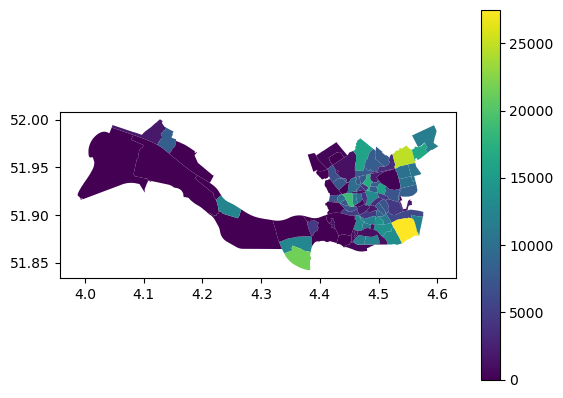

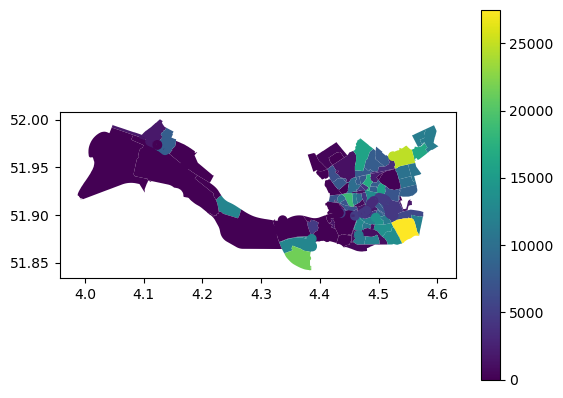

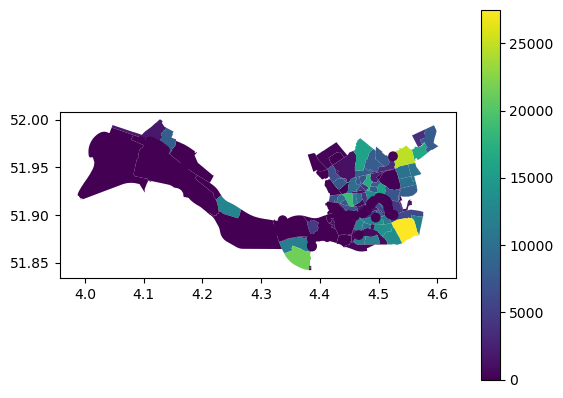

In [22]:
# # plot the data
# fig, ax = plt.subplots(1,1, figsize=(10,10))
# cbs_map_2012.boundary.plot(ax=ax, color='black')
# intersections.boundary.plot(ax=ax, color='red', alpha=0.5)
# new_attribute.boundary.plot(ax=ax, color='blue', alpha=0.5)
# plt.show()

cbs_map_2012.plot(column='AANT_INW', legend=True)
intersections.plot(column='old_attribute', legend=True)
new_attribute.plot(column='new_attribute', legend=True)

In [69]:
query = ''' 
WITH nl_buurten AS (
	SELECT * FROM nl_buurten 
), 
cbs_map_2012 AS (
	SELECT * FROM cbs_map_2012 
	WHERE "GM_NAAM" = 'Amsterdam' -- AND "BU_CODE" = 'BU03630551'
), 
intersections AS (
	SELECT 
	    b2022.neighborhood_code AS buurt_id_2022,
	    ST_Transform(b2022.neighborhood_geom, 4326) AS geom_2022,
		b2022.neighborhood, b2022.municipality, 
	    
		b2012."BU_CODE" AS buurt_id_2012,
		ST_Transform(b2012.geometry, 4326) AS geom_2012, 
		ST_Area(b2012.geometry) AS old_area,
		b2012."AANT_INW" AS old_attribute, 
		
		ST_Transform(ST_Intersection(b2022.neighborhood_geom, b2012.geometry), 4326) AS geom_intersection,
	    ST_Area(ST_Intersection(b2022.neighborhood_geom, b2012.geometry)) AS intersection_area
	FROM nl_buurten b2022
	JOIN cbs_map_2012 b2012
	ON ST_Intersects(b2022.neighborhood_geom, b2012.geometry)
), 
new_attribute AS (
	SELECT 
		ROUND(intersection_area / old_area * old_attribute) AS new_attribute, * 
	FROM intersections 
)

SELECT * FROM intersections 
'''

geom_2022 = gpd.read_postgis(query, engine, geom_col='geom_2022')
geom_2012 = gpd.read_postgis(query, engine, geom_col='geom_2012')
geom_intersection = gpd.read_postgis(query, engine, geom_col='geom_intersection')

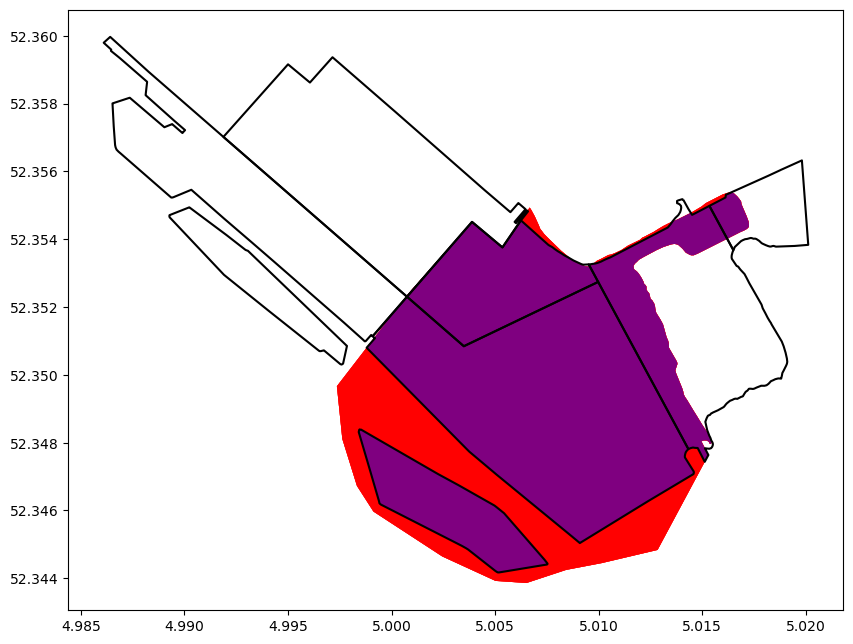

In [71]:
fig, ax = plt.subplots(1,1, figsize=(10,10))
geom_2022.boundary.plot(ax=ax, color='black')
geom_2012.plot(ax=ax, color='red', alpha=0.5)
geom_intersection.plot(ax=ax, color='blue', alpha=0.5)
plt.show()

# Finding problem neighborhoods in Almere - looking at one neighborhood at a time

In [64]:
neighborhoods = pd.read_sql('''SELECT DISTINCT "BU_CODE" FROM cbs_map_2012 WHERE "GM_NAAM" = \'Amsterdam\'''', engine)
neighborhoods = list(neighborhoods.BU_CODE)

mismatch_df = pd.DataFrame(columns=['neighborhood', 'population_2012', 'population_2022'])
for neighborhood in neighborhoods: 
    query = f''' 
    WITH nl_buurten AS (
        SELECT * FROM nl_buurten 
    ), 
    cbs_map_2012 AS (
        SELECT * FROM cbs_map_2012 
        WHERE "GM_NAAM" = 'Amsterdam' AND "BU_CODE" = '{neighborhood}'
    ), 
    intersections AS (
        SELECT 
            b2022.neighborhood_code AS buurt_id_2022,
            ST_Transform(b2022.neighborhood_geom, 4326) AS geom_2022,
            b2022.neighborhood, b2022.municipality, 
            
            b2012."BU_CODE" AS buurt_id_2012,
            ST_Transform(b2012.geometry, 4326) AS geom_2012, 
            ST_Area(b2012.geometry) AS old_area,
            b2012."AANT_INW" AS old_attribute, 
            
            ST_Transform(ST_Intersection(b2022.neighborhood_geom, b2012.geometry), 4326) AS geom_intersection,
            ST_Area(ST_Intersection(b2022.neighborhood_geom, b2012.geometry)) AS intersection_area
        FROM nl_buurten b2022
        JOIN cbs_map_2012 b2012
        ON ST_Intersects(b2022.neighborhood_geom, b2012.geometry)
    ), 
    new_attribute AS (
        SELECT 
            ROUND(intersection_area / old_area * old_attribute) AS new_attribute, * 
        FROM intersections 
    )
    '''
    # get population of neighborhood based on 2012 boundaries
    query_addition = 'SELECT SUM("AANT_INW") FROM cbs_map_2012'
    population_2012 = pd.read_sql(query + query_addition, engine).iloc[0,0]
    # get population of neighborhood based on 2022 boundaries (subdivided)
    query_addition = 'SELECT SUM(new_attribute) FROM new_attribute'
    population_2022 = pd.read_sql(query + query_addition, engine).iloc[0,0]

    mismatch_row = pd.DataFrame({'neighborhood': [neighborhood], 'population_2012': [population_2012], 'population_2022': [population_2022]})
    mismatch_df = pd.concat([mismatch_df, mismatch_row], ignore_index=True)

/var/folders/r0/dcf480211ql6v50vx1qh0m080000gn/T/ipykernel_88498/3584166543.py:45: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  mismatch_df = pd.concat([mismatch_df, mismatch_row], ignore_index=True)


In [65]:
mismatch_df['difference'] = mismatch_df['population_2022'] - mismatch_df['population_2012']
mismatch_df # .difference.sum()
print(f'There are {mismatch_df[mismatch_df.difference != 0].shape[0]} problem neighborhoods in Amsterdam')
print(f'Population 2012: {mismatch_df.population_2012.sum()}')
print(f'Population 2022: {mismatch_df.population_2022.sum()}')
print(f'Difference: {mismatch_df.difference.sum()}')

There are 52 problem neighborhoods in Amsterdam
Population 2012: 790090.0
Population 2022: 787638.0
Difference: -2452.0


In [66]:
mismatch_df.sort_values(by='difference', ascending=True)

,neighborhood,population_2012,population_2022,difference
70,BU03630551,5475.0,4279.0,-1196.0
69,BU03630535,13665.0,12473.0,-1192.0
68,BU03630534,805.0,770.0,-35.0
89,BU03630673,2170.0,2162.0,-8.0
77,BU03630661,8200.0,8197.0,-3.0
...,...,...,...,...
21,BU03630221,7545.0,7546.0,1.0
22,BU03630222,1750.0,1751.0,1.0
14,BU03630214,12405.0,12406.0,1.0
57,BU03630454,8900.0,8902.0,2.0


year: 2018


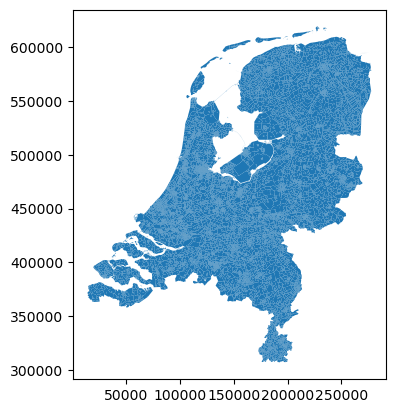

year: 2019


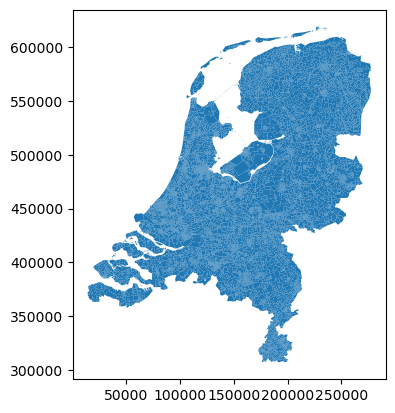

year: 2020


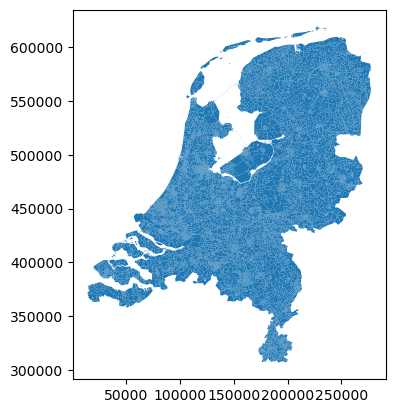

year: 2021


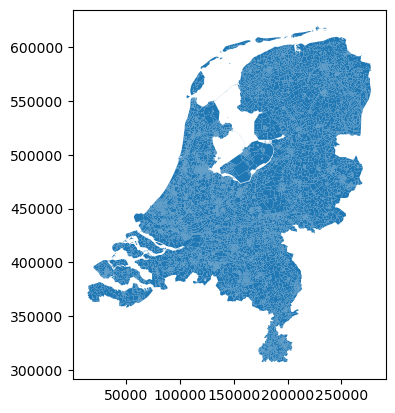

In [10]:
for year in range(2018, 2022):
    print(f'year: {year}')

    water_col = 'WATER' if year < 2018 else 'H2O'
    query = f''' 
    SELECT * 
    FROM cbs_map_{year}
    WHERE "{water_col}" = 'NEE' 
    '''
    gdf = gpd.read_postgis(query, engine, geom_col='geometry')
    gdf.plot()
    plt.show()

14317


<Axes: >

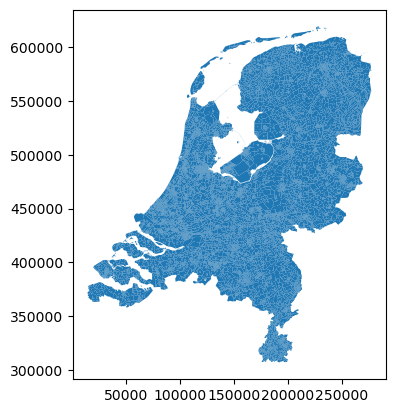

In [15]:
query = ''' 
SELECT 
    geometry AS neighborhood_geom, 
    "BU_CODE" AS neighborhood_code, 
    "BU_NAAM" AS neighborhood, 
    "GM_NAAM" AS municipality, 
    NULL AS province 
FROM cbs_map_2022
WHERE "H2O" = 'NEE'
'''

gdf = gpd.read_postgis(query, engine, geom_col='neighborhood_geom')
print(len(gdf))
gdf.plot()

14317


<Axes: >

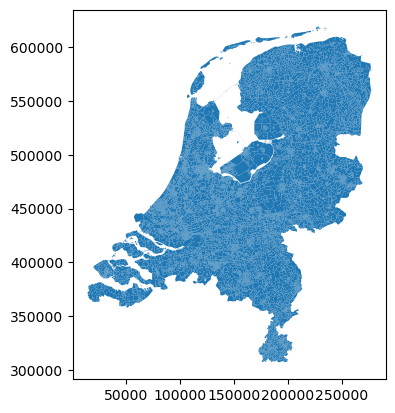

In [17]:
query = ''' 
SELECT * FROM nl_buurten
'''
gdf = gpd.read_postgis(query, engine, geom_col='neighborhood_geom')
print(len(gdf))
gdf.plot()

In [9]:
from data_processing._common.database_manager import DatabaseManager
municipalities = DatabaseManager().get_municipalities_list()
for municipality in municipalities:
    for year in range(2018, 2022): 
        print(f'Year {year}, {municipality}')
        query = f''' 
        SELECT * 
        FROM emissions_embodied_housing_nl
        WHERE year = {year} AND municipality = '{municipality}'
        '''
        df = pd.read_sql(query, engine)
        embodied_emissions = df.emissions_embodied_kg.sum()

        query = f'''
        WITH embodied_emissions AS (
            SELECT * 
            FROM emissions_embodied_housing_nl
            WHERE year = {year} AND municipality = '{municipality}'
        ), 
        embodied_emissions_buurt AS (
            SELECT 
                municipality, neighborhood_code, 
                SUM(emissions_embodied_kg) AS embodied_emissions_kg, 
                SUM(sqm) AS sqm
            FROM embodied_emissions
            GROUP BY municipality, neighborhood_code 
        )
        SELECT * FROM embodied_emissions_buurt
        '''
        df = pd.read_sql(query, engine)
        embodied_emissions_buurt = df.embodied_emissions_kg.sum()

        query = f''' 
        WITH operational_emissions AS (
            SELECT * 
            FROM cbs_map_all 
            WHERE year = {year} AND gm_naam = '{municipality}'
        ), 
        embodied_emissions AS (
            SELECT * 
            FROM emissions_embodied_housing_nl
            WHERE year = {year} AND municipality = '{municipality}'
        ), 
        embodied_emissions_buurt AS (
            SELECT 
                municipality, neighborhood_code, 
                SUM(emissions_embodied_kg) AS embodied_emissions_kg, 
                SUM(sqm) AS sqm
            FROM embodied_emissions
            GROUP BY municipality, neighborhood_code 
        ), 
        emissions_all AS (
            SELECT 
                o.year, o.bu_code, o.bu_naam, o.gm_naam, o.geometry, o.geom_4326, 
                o.emissions_kg_total, e.embodied_emissions_kg, 
                o.emissions_kg_total + e.embodied_emissions_kg AS emissions_total, 
                o.aantal_hh, o.aant_inw, e.sqm, o.woz
            FROM operational_emissions o 
            FULL JOIN embodied_emissions_buurt e  
            ON o.bu_code = e.neighborhood_code 
        )
        SELECT * FROM emissions_all
        '''
        df = pd.read_sql(query, engine)
        emissions_all = df.embodied_emissions_kg.sum()

        if embodied_emissions != embodied_emissions_buurt:
            print(f'Year {year}, {municipality}: embodied_emissions {embodied_emissions}, embodied_emissions_buurt {embodied_emissions_buurt}')
        elif embodied_emissions != emissions_all:
            print(f'Year {year}, {municipality}: embodied_emissions {embodied_emissions}, emissions_all {emissions_all}')
        elif embodied_emissions_buurt != emissions_all:
            print(f'Year {year}, {municipality}: embodied_emissions_buurt {embodied_emissions_buurt}, emissions_all {emissions_all}')

Year 2018, Montfoort
Year 2019, Montfoort
Year 2020, Montfoort
Year 2021, Montfoort
Year 2018, Alkmaar
Year 2019, Alkmaar
Year 2020, Alkmaar
Year 2021, Alkmaar
Year 2018, Katwijk
Year 2019, Katwijk
Year 2020, Katwijk
Year 2021, Katwijk
Year 2018, Nissewaard
Year 2019, Nissewaard
Year 2020, Nissewaard
Year 2021, Nissewaard
Year 2018, Hollands Kroon
Year 2019, Hollands Kroon
Year 2020, Hollands Kroon
Year 2021, Hollands Kroon
Year 2018, Hilvarenbeek
Year 2019, Hilvarenbeek
Year 2020, Hilvarenbeek
Year 2021, Hilvarenbeek
Year 2018, Leidschendam-Voorburg
Year 2019, Leidschendam-Voorburg
Year 2020, Leidschendam-Voorburg
Year 2021, Leidschendam-Voorburg
Year 2018, Oirschot
Year 2019, Oirschot
Year 2020, Oirschot
Year 2021, Oirschot
Year 2018, De Bilt
Year 2019, De Bilt
Year 2020, De Bilt
Year 2021, De Bilt
Year 2018, Nijkerk
Year 2019, Nijkerk
Year 2020, Nijkerk
Year 2021, Nijkerk
Year 2018, Doetinchem
Year 2019, Doetinchem
Year 2020, Doetinchem
Year 2021, Doetinchem
Year 2018, Montferland
Y

ProgrammingError: (psycopg2.errors.SyntaxError) syntax error at or near "s"
LINE 4:         WHERE year = 2018 AND municipality = ''s-Gravenhage'
                                                       ^

[SQL:  
        SELECT * 
        FROM emissions_embodied_housing_nl
        WHERE year = 2018 AND municipality = ''s-Gravenhage'
        ]
(Background on this error at: https://sqlalche.me/e/20/f405)

In [6]:
gdf = gpd.read_file('../data/raw/landuse/landuse.gml')

In [8]:
gdf.description.unique()

array(['Railroad', 'Main road', 'Airport', 'Residential',
       'Retail trade, hotel and catering', 'Public institutions',
       'Socio-cultural facility', 'Industrial area and offices',
       'Dumping site', 'Car wreck site', 'Cemetery', 'Mining area',
       'Building site', 'Other semi built-up area',
       'Park and public garden', 'Sports ground (incl. car parks)',
       'Allotment garden', 'Area for daytrips', 'Holiday recreation',
       'Greenhouses', 'Other agricultural usage', 'Woodland',
       'Dry natural area', 'Wet natural area', 'Ijsselmeer of Markermeer',
       'Enclosed estuary', 'Rijn & Maas', 'Randmeer', 'Water reservoir',
       'Water with recreational usage',
       'Water where minerals are extracted',
       'Area for storing industrial water', 'Other inland water',
       'Waddenzee, Eems, Dollard', 'Oosterschelde', 'Westerschelde',
       'Noordzee', 'Foreign countries'], dtype=object)

In [3]:
from osgeo import ogr

# Path to your GML file
gml_file_path = '../data/raw/landuse/landuse.gml'

# Step 1: Open the GML file
gml_driver = ogr.GetDriverByName('GML')
gml_data_source = gml_driver.Open(gml_file_path, 0)  # 0 means read-only mode

if gml_data_source is None:
    print("Could not open GML file")
    exit()

# Step 2: Get the first layer
layer = gml_data_source.GetLayerByIndex(0)

if layer is None:
    print("No layer found in the GML file")
    exit()

print(f"Layer Name: {layer.GetName()}")
print(f"Number of features: {layer.GetFeatureCount()}")

# Step 3: Check geometries and properties for the first 10 features
feature_count = 0
geometry_count = 0
max_features = 10  # Limit to the first 10 features

for feature in layer:
    if feature_count >= max_features:
        break

    feature_count += 1
    geom = feature.GetGeometryRef()
    
    if geom is not None:
        geometry_count += 1
        print(f"Feature {feature_count}: Geometry Type: {geom.GetGeometryName()}")
    else:
        print(f"Feature {feature_count}: No geometry found")
    
    # Step 4: Inspect properties and handle duplicates
    properties = feature.items()  # Extract properties as a dictionary
    print(f"Feature {feature_count}: Properties (Raw): {properties}")
    
    # Handle duplicates if necessary
    seen_fields = set()
    cleaned_properties = {}
    for key, value in properties.items():
        if key in seen_fields:
            print(f"Duplicate field '{key}' detected. Handling...")
            # Optionally, rename the duplicate or ignore it (e.g., use a suffix or only keep the first occurrence)
            cleaned_properties[f"{key}_duplicate"] = value
        else:
            cleaned_properties[key] = value
            seen_fields.add(key)
    
    print(f"Feature {feature_count}: Cleaned Properties: {cleaned_properties}")

print(f"\nTotal features processed: {feature_count}")
print(f"Total features with geometries: {geometry_count}")

# Close the data source
gml_data_source = None



Layer Name: ExistingLandUseObject
Number of features: 171543
Feature 1: Geometry Type: MULTIPOLYGON
Feature 1: Properties (Raw): {'gml_id': 'BBG2017_1', 'description': 'Railroad', 'name': '4_1_2', 'localId': 'BBG2017_1', 'namespace': 'NL.CBS.LU.ExistingLandUseObject', 'beginLifespanVersion': None, 'hilucsPresence': None, 'specificPresence': None, 'observationDate': '2017-07-31', 'validFrom': '2017-04-15', 'validTo': '2017-09-15'}
Feature 1: Cleaned Properties: {'gml_id': 'BBG2017_1', 'description': 'Railroad', 'name': '4_1_2', 'localId': 'BBG2017_1', 'namespace': 'NL.CBS.LU.ExistingLandUseObject', 'beginLifespanVersion': None, 'hilucsPresence': None, 'specificPresence': None, 'observationDate': '2017-07-31', 'validFrom': '2017-04-15', 'validTo': '2017-09-15'}
Feature 2: Geometry Type: MULTIPOLYGON
Feature 2: Properties (Raw): {'gml_id': 'BBG2017_2', 'description': 'Railroad', 'name': '4_1_2', 'localId': 'BBG2017_2', 'namespace': 'NL.CBS.LU.ExistingLandUseObject', 'beginLifespanVersion'

Warning 1: Field with same name (description) already exists in (ExistingLandUseObject). Skipping newer ones
Warning 1: Field with same name (name) already exists in (ExistingLandUseObject). Skipping newer ones


In [5]:
query = ''' 
SELECT neighborhood_code, geom
FROM housing_nl
WHERE
    municipality = 'Amsterdam'
    AND neighborhood_code !~ '^BU\d{8}$'
'''
gdf = gpd.read_postgis(query, engine, geom_col='geom')

In [9]:
# plot gdf on folium
m = folium.Map(location=[52.3702, 4.8952], zoom_start=12)
folium.GeoJson(gdf.sample(10000)).add_to(m)
m